In [1]:
import numpy as np
import h5py
import matplotlib.pylab as plt
import sys
import plotly.express as px
import plotly.offline as py
import plotly.graph_objects as go
import plotly.io as pio
import seaborn as sns
sys.path.append('../../src/')

from tqdm import tqdm
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# custom scripts
import mri_cs
from visualization import plot_batch
from helpers import signal_to_error
from spiraltrajectory import spiral_samples_trajectory, kspace_measurements_spiral, minimum_energy_reconstruction

layout = go.Layout(template="plotly_dark")
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'
plt.style.use('dark_background')

py.init_notebook_mode()

In [20]:
DATA_PATH = '/home/gabrielziegler/FastMRIData/multicoil_challenge/'
FILE_SAMPLE = DATA_PATH + 'file1000083.h5'

hf = h5py.File(FILE_SAMPLE, mode='r')
list(hf.keys())
dict(hf.attrs)

['ismrmrd_header', 'kspace', 'mask']

{'acceleration': 4,
 'acquisition': 'CORPDFS_FBK',
 'num_low_frequency': 30,
 'patient_id': '2a8ff2b5bb8af1ddd44d08dbaa8e3e5cdf5c578f7d68b45aad6af8458766d029'}

# Number of slices x number of coils x height x width

In [22]:
volume_kspace = hf['kspace'][()]
volume_kspace.shape
volume_kspace.dtype

(30, 15, 640, 372)

dtype('complex64')

In [23]:
slice_kspace = volume_kspace[20]
slice_kspace.shape

rows = 640
cols = 368
image_size = rows * cols
image_size

(15, 640, 372)

235520

# Combine from coil extractions with RSS

(15, 640, 372)

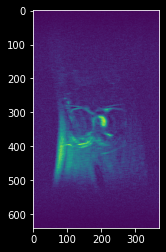

In [69]:
slice_kspace.shape
_ = plt.imshow(np.abs(np.fft.fftshift(np.fft.ifft2(slice_kspace[14]))))

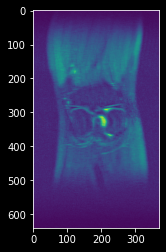

In [70]:
def combine_coils_rss(data, dim=0):
    data = np.fft.ifftshift(data)
    data = np.fft.ifft2(data)
    data = np.fft.fftshift(data)
#     data = np.abs(data)
    # Root Sum of Squares RSS
    data = np.sqrt((data ** 2)).sum(dim)
    return data

combined_slice = combine_coils_rss(slice_kspace)
_ = plt.imshow(np.abs(combined_slice))

# Extract samples rows measurements from kspace coil sample

In [6]:
def get_indices(arr: np.array) -> np.array:
    arr = arr.flatten()
    indices = np.where(arr != 0)[0]
    nonzero_perc = indices.size / arr.size
    print(f'{nonzero_perc:.2f}% non zero elements')
    return indices

samples_rows = get_indices(slice_kspace[0])
samples_rows.size
samples_rows

0.13% non zero elements


30080

array([    22,     26,     33, ..., 235447, 235449, 235488])

In [7]:
slice_kspace[0].flatten().shape

(235520,)

In [8]:
Bs = np.array([coil_sample.flatten()[samples_rows] for coil_sample in slice_kspace]) 
Bs.size
Bs.shape
Bs[0].shape
Bs[0]

451200

(15, 30080)

(30080,)

array([ 4.9115624e-06-3.4407713e-06j,  1.6652048e-06+1.4994293e-06j,
       -4.2628963e-06-1.5592668e-06j, ..., -2.1622982e-06+1.3397075e-06j,
        5.2130781e-07+1.3231765e-06j, -2.0123553e-06-1.0833610e-06j],
      dtype=complex64)

# Compressed sensing indirect method

In [9]:
A_ = lambda x: np.fft.fft2(np.reshape(x, (rows, cols))).flatten()[samples_rows]
stacked_image_size = rows * cols

def ah(x):
    x = fill_with_zeros(x, samples_rows, stacked_image_size)
#     x = np.fft.ifftshift(x)
    x = np.fft.ifft2(x)
#     x = np.fft.fftshift(x)
    x = x * (stacked_image_size)
    x = x.flatten()
    return x

def fill_with_zeros(x, samples_rows, stacked_image_size):
    y = np.zeros((stacked_image_size), dtype=complex)

    y[samples_rows] = x
    y = np.reshape(y, (rows, cols))
    return y

In [10]:
reconstructed_imgs = []
img_size = rows * cols

for b in tqdm(Bs):
    recon_img = mri_cs.lpminimization(A_, Ah=ah, b=b, p=1, N=(img_size), verbose=False)
    reconstructed_imgs.append(recon_img)

100%|██████████| 15/15 [00:44<00:00,  2.98s/it]


In [11]:
len(reconstructed_imgs)
reconstructed_imgs[0]
reconstructed_imgs[0][0].shape

15

array([-1.56934574e-08+1.46877376e-09j,  1.39439424e-08-2.97364404e-10j,
       -1.85106140e-08+8.40749036e-10j, ...,
       -1.03728513e-08+3.45082082e-10j,  1.43497876e-08-1.05858129e-09j,
       -1.52642146e-08+5.79341050e-11j])

()

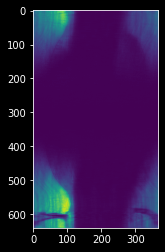

In [12]:
plt.imshow(np.abs(np.reshape(reconstructed_imgs[5], (rows, cols))));

In [13]:
reconstructed_imgs[0].shape

(235520,)

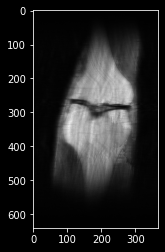

In [14]:
def combine_coils_rss(data, dim=0):
    if len(data[0].shape) == 1:
        data = [np.reshape(flat_arr, (rows, cols)) for flat_arr in data]
    data = np.fft.ifftshift(data)
#     data = np.fft.ifft2(data)
#     data = np.fft.fftshift(data)
# #     data = np.abs(data)
#     # Root Sum of Squares RSS    
    data = np.sqrt((data ** 2)).sum(dim)
    return data

combined_reconstructed = combine_coils_rss(reconstructed_imgs)
_ = plt.imshow(np.abs(combined_reconstructed), cmap='gray')

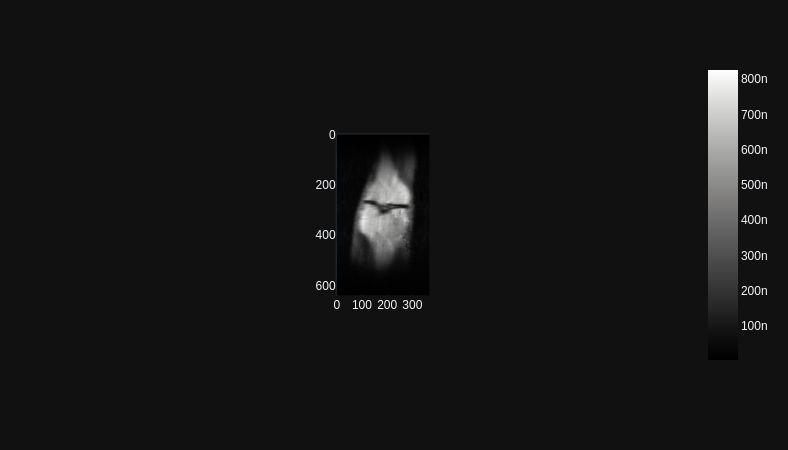

In [17]:
px.imshow(np.abs(combined_slice), color_continuous_scale='gray')

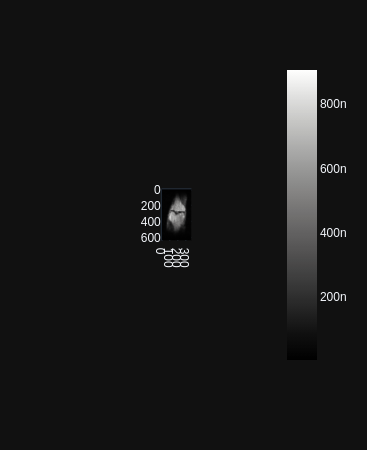

In [18]:
px.imshow(np.abs(combined_reconstructed), color_continuous_scale='gray')

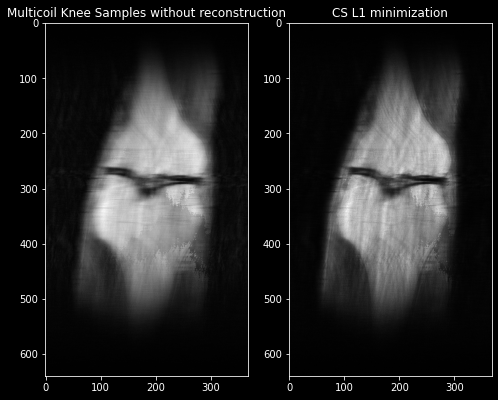

In [15]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 15))
_ = axes[0].imshow(np.abs(combined_slice), cmap='gray')
_ = axes[0].set_title('Multicoil Knee Samples without reconstruction')
_ = axes[1].imshow(np.abs(combined_reconstructed), cmap='gray')
_ = axes[1].set_title('CS L1 minimization')